<h1> <font color=blue><center> Loan Prediction<font><h1/>
    
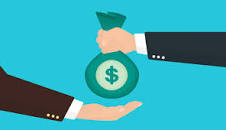

### 1. Problem Definition

1. Identify and visualize which factors contribute to  Loan Approval:

2. Build a prediction model that will perform the following:

    - Classify whether a  Applicant Loan status  should be approved or not.In other words, which customer will have their loans approved or not
    - Preferably and based on model performance, choose a model that will attach a probability to the loan to make it easier for Bank or other financial institutions  to approve or reject loans Application.

### 2. Data

The data is obtained from [Kaggle](https://www.kaggle.com/) and can be downloaded from [Loan Prediction Problem Dataset](https://www.kaggle.com/datasets/altruistdelhite04/loan-prediction-problem-dataset?resource=download&select=train_u6lujuX_CVtuZ9i.csv). Each row represents a Loan applicant , each column contains the loan applicant's attributes described in the data dictionary.

The raw data contains 614 rows (applicants) and 13 columns (12 features & 1 target)

<center>

##### Data Dictionary

|No.|Name of the column|Description|Type|
|---|------------------|-----------|----|
|1.|Loan_ID|Unique Loan identification number|Object|
|2.|Gender|Whether the loan applicant/client  is a male or a female|Obejct|
|3.|Married|Whether the loan applicant is married or not|Obejct|
|4.|Dependents|Number of persons depending on the loan applicant/client|Object|
|5.|Education|Loan applicant education (Graduate/Undergraduate)|Object|
|6.|Self_Employed|Self employed status of client (Yes/No)|Object|
|7.|ApplicantIncome|The loan applicant income|int64|
|8.|Coapplicant income|The Coapplicant income|float64|
|9.|LoanAmount|The loan amount in thousands|float64|
|10.|Loan_Amount_Term|Terms of loan in months|float64|
|11.|Credit_History|Whether the client credit history meet guidelines|float64|
|12.|Property_Area|Urban/Semi and Rural|Object|
|13.|Loan_Status|Whether the client loan is approved or not (Yes/No)|Object|

### LIBRARIES IMPORTS

In [1]:
#Installing the dependencies
from dataprep.eda import plot, plot_correlation, plot_missing, create_report

#Installing the dependencies
from pandas_profiling import ProfileReport
Profile = ProfileReport()

#Installing the dependencies
import sweetviz as sv 



#import sweetviz as sv
#report = sv.analyze()
#report.show_html()

# libraries For loading and manipulating data
import pandas as pd
import numpy as np
from math import ceil,floor
from scipy.stats import iqr

#For data exploration
import matplotlib.pyplot as plt
import plotly.express as px #for visualization
 
import seaborn as sns
from matplotlib.patches import Patch

# for data oversampling
from imblearn.over_sampling import SMOTE
from imblearn.over_sampling import RandomOverSampler
from imblearn.under_sampling import RandomUnderSampler


# Machine learning
import xgboost as xgb
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import OneHotEncoder, StandardScaler
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.neural_network import MLPClassifier
from sklearn.metrics import recall_score,f1_score,accuracy_score,classification_report,roc_curve,roc_auc_score,precision_score
from sklearn.metrics import confusion_matrix,plot_confusion_matrix,plot_precision_recall_curve,plot_roc_curve
import warnings
warnings.filterwarnings('ignore')

NumExpr defaulting to 8 threads.


Pandas backend loaded 1.4.2
Numpy backend loaded 1.21.5
Pyspark backend NOT loaded
Python backend loaded


In [2]:
# Load the data and check the first few rows
df =pd.read_csv('/Users/shegeb/Documents/BGSU/Fall 2022/CS 6010 (Data Science Programming)/Final Project/dataset/train.csv')
df.head()

,Loan_ID,Gender,Married,Dependents,Education,Self_Employed,ApplicantIncome,CoapplicantIncome,LoanAmount,Loan_Amount_Term,Credit_History,Property_Area,Loan_Status
0,LP001002,Male,No,0,Graduate,No,5849,0.0,NaN,360.0,1.0,Urban,Y
1,LP001003,Male,Yes,1,Graduate,No,4583,1508.0,128.0,360.0,1.0,Rural,N
2,LP001005,Male,Yes,0,Graduate,Yes,3000,0.0,66.0,360.0,1.0,Urban,Y
3,LP001006,Male,Yes,0,Not Graduate,No,2583,2358.0,120.0,360.0,1.0,Urban,Y
4,LP001008,Male,No,0,Graduate,No,6000,0.0,141.0,360.0,1.0,Urban,Y


In [5]:
# Print the number of rows and columns
print(f'There are {df.shape[0]} rows and {df.shape[1]} columns.')

There are 614 rows and 13 columns.


#### 2.1 Data Cleaning

In [6]:
# Check the column names
df.columns

Index(['Loan_ID', 'Gender', 'Married', 'Dependents', 'Education',
       'Self_Employed', 'ApplicantIncome', 'CoapplicantIncome', 'LoanAmount',
       'Loan_Amount_Term', 'Credit_History', 'Property_Area', 'Loan_Status'],
      dtype='object')

##### **camelCase to snake_case**
It looks that the column names are in camel case. Let's convert it to snake case to follow the python style guide. Let us write a function for that.

In [7]:
# Function to Split camel case string to individual strings
 
def camel_case_split(str):
    '''Convert camel case to snake case'''
    word = []
    word_1=[]
 
    for c in range(len(str)):
        #Find the upper case letter in the string
        if str[c].isupper() and c >0:
            #Split the word
            word=str[:c].lower()
            word_1=str[c:].lower()
            #Convert to snake case
            return f'{word}_{word_1}'
            break
    return str.lower()

In [8]:
# Convert the column names to snake case
df.rename(columns={c:camel_case_split(c) for c in df.columns},inplace=True)

#### Feature Selection

The Loan_ID column is a unique identifier of the customer and is not useful in this exercise. Let's drop it.

In [9]:
# Dropping the customer_id column
df.drop(columns=['loan__id'],inplace=True)

#### Check the data type to see if we need to convert them to appropriate data types

In [10]:
df.dtypes

gender                 object
married                object
dependents             object
education              object
self__employed         object
applicant_income        int64
coapplicant_income    float64
loan_amount           float64
loan__amount_term     float64
credit__history       float64
property__area         object
loan__status           object
dtype: object

### Summary  Statistics Report of the Dataset




In [11]:
#summary statistics
#df.describe()

  0%|                                                  | 0/1518 [00:00<?, ?it/s]

DataPrep Report
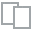
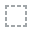
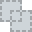
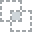
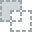
...
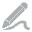
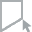
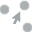
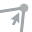
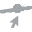

In [12]:
#Profile = ProfileReport(df)
#Profile

create_report(df)

#### Missing values

In [13]:
#missing values in decsending order
df.isnull().sum().sort_values(ascending=False)

credit__history       50
self__employed        32
loan_amount           22
dependents            15
loan__amount_term     14
gender                13
married                3
education              0
applicant_income       0
coapplicant_income     0
property__area         0
loan__status           0
dtype: int64

Text(0.5, 1.0, 'Missing Values')

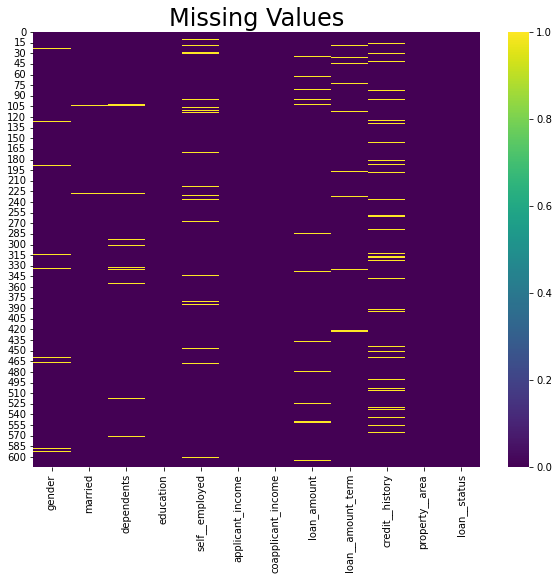

In [14]:
#Plot missing values
# Define the figure size
plt.figure(figsize=(10,8))
# Plot the heatmap
sns.heatmap(df.isnull(),cmap="viridis").set_title("Missing Values",fontdict= { 'fontsize': 24})

  0%|                                                   | 0/158 [00:00<?, ?it/s]


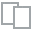
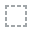
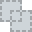
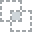
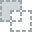
...
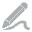
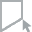
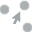
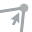
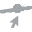

In [15]:
plot_missing(df)

### Imputation
**** Our approach to dealing with the missing values ****

--- If it is a normal distribution and a numeric column, then replace  the missing values with the mean

--- If it is right skewed/ left skewed and a numeric column, fill it  with median value or mode  which is more robust than mean 

--- If it is right skewed/ left skewed and a categorical column, fill the string/categorical  columns with the mode. Each value will be replaced by the most frequent value (mode).

--- gender, married, dependent, self_employed are object/string our categorical features

--- loan_amount, loan__amount_term, credit_history are float/ numeric features


Visualization of right-skewed loan_amount feature



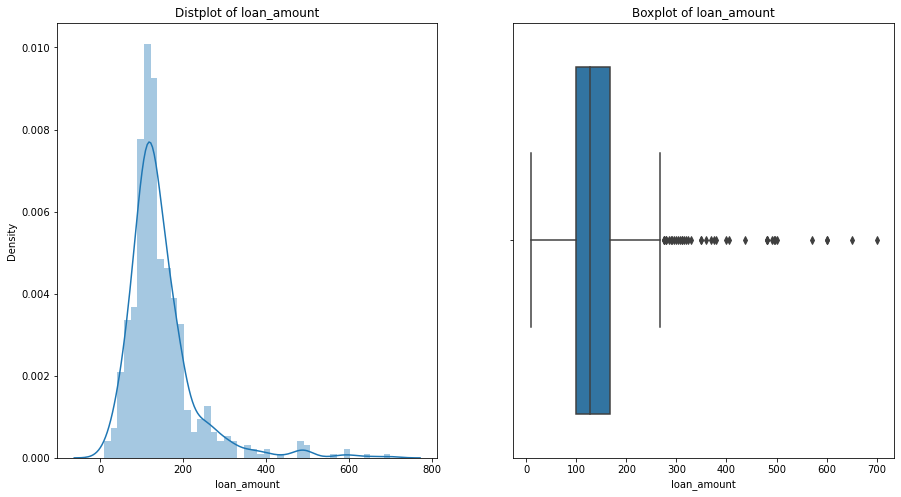

In [16]:
print("Visualization of right-skewed loan_amount feature"'\n')

fig, (axs1, axs2) = plt.subplots(1,2, figsize=(15,8))


sns.distplot(df['loan_amount'],ax=axs1)
axs1.set_title("Distplot of loan_amount");


sns.boxplot (df['loan_amount'], ax=axs2)
axs2.set_title("Boxplot of loan_amount");

Visualization of left-skewed loan__amount_term feature



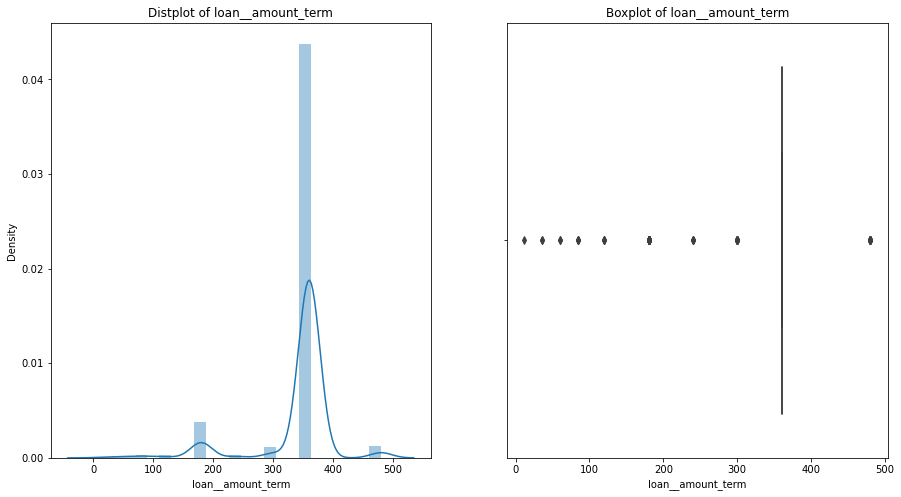

In [15]:
print("Visualization of left-skewed loan__amount_term feature"'\n')

fig, (axs1, axs2) = plt.subplots(1,2, figsize=(15,8))


sns.distplot(df['loan__amount_term'],ax=axs1)
axs1.set_title("Distplot of loan__amount_term");


sns.boxplot (df['loan__amount_term'], ax=axs2)
axs2.set_title("Boxplot of loan__amount_term");


Visualization of left-skewed credit_history feature



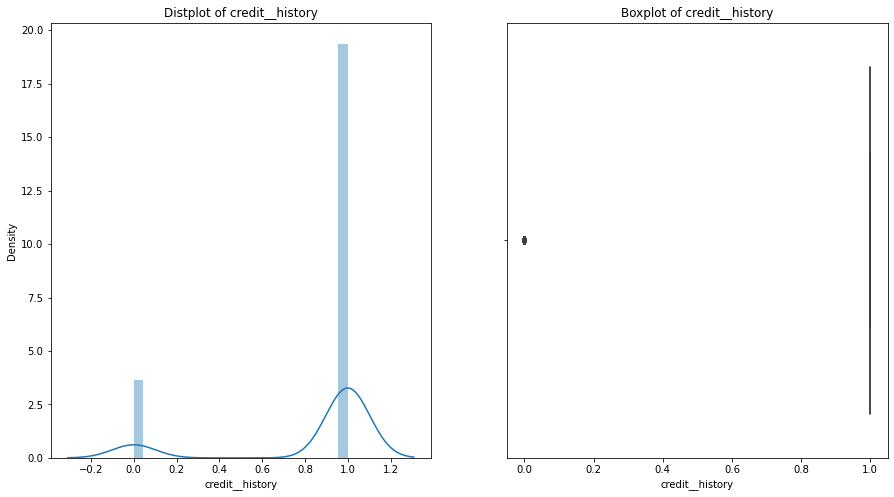

In [16]:
print("Visualization of left-skewed credit_history feature"'\n')

fig, (axs1, axs2) = plt.subplots(1,2, figsize=(15,8))


sns.distplot(df['credit__history'],ax=axs1)
axs1.set_title("Distplot of credit__history");


sns.boxplot (df['credit__history'], ax=axs2)
axs2.set_title("Boxplot of credit__history");

In [17]:
## Filling gender, married, dependent, self_employed and credit_history  with mode

df['gender']=df['gender'].fillna(df['gender'].mode()[0])  
df['married']=df['married'].fillna(df['married'].mode()[0]) 
df['dependents']=df['dependents'].fillna(df['dependents'].mode()[0]) 
df['self__employed']=df['self__employed'].fillna(df['self__employed'].mode()[0]) 
df['credit__history']=df['credit__history'].fillna(df['credit__history'].mode()[0])


# Filling loan_amount & loan_amount_Term with median

df['loan_amount']=df['loan_amount'].fillna(df['loan_amount'].median()) 
df['loan__amount_term']=df['loan__amount_term'].fillna(df['loan__amount_term'].median()) 

#### Check to see whether null values have been successfully replaced

In [18]:
df.isnull().sum()

gender                0
married               0
dependents            0
education             0
self__employed        0
applicant_income      0
coapplicant_income    0
loan_amount           0
loan__amount_term     0
credit__history       0
property__area        0
loan__status          0
dtype: int64

In [19]:
#report =  sv.analyze(df)
#report.show_html()

### 2.1 Data Exploration 

For the purpose of exploration, we will divide the feature in the following categories:
1. Demographics
    - gender                 
    - married                        
    - dependents
    - education
2. Loan Information 
    - self__employed  
    - property__area
    - applicant_income   
    - coapplicant_income 
    - loan_amount  
    - loan__amount_term    
    - credit__history
3. Target
    - loan__status

In [20]:
# Print the number of categorical and numeric features
print(f"There are {len(df.select_dtypes(include='object').columns)} categorical columns and {len(df.select_dtypes(include='number').columns)} numeric columns.")

There are 7 categorical columns and 5 numeric columns.


### QUICK SIMPLE VISUALIZATION/GLANCE  OF THE ENTIRE DATASET 

  0%|                                                   | 0/447 [00:00<?, ?it/s]


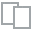
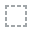
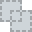
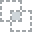
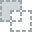
...
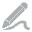
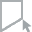
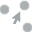
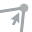
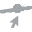

In [21]:
plot(df)

#### Covariance Matrix  of the entire Dataset

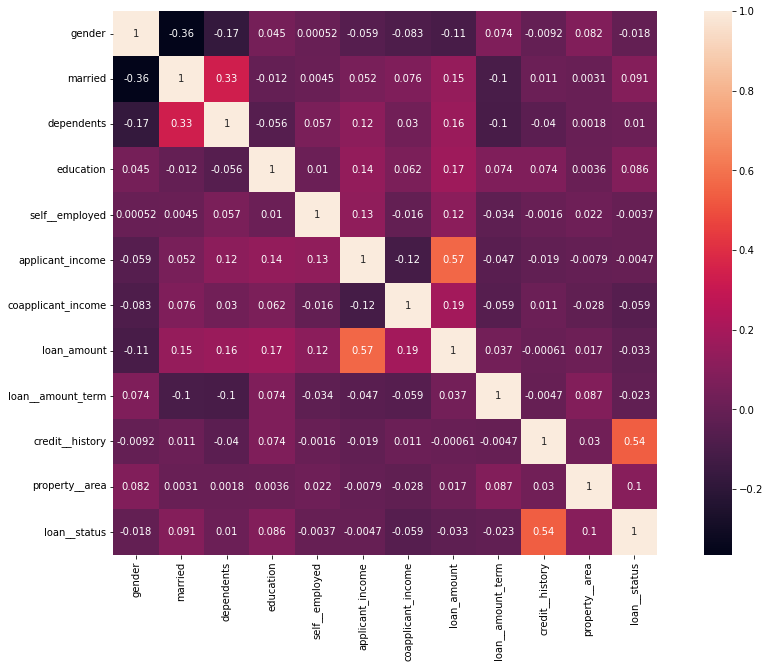

In [22]:
# check for any correlation between all features


# creating a copy of the original dataframe
data= df.copy()

for i in [data]:
    i["gender"] = i["gender"].map({"Male":0, "Female":1}).astype(int)
    i["married"] = i[ "married"].map({'No' :0, "Yes":1}).astype (int)
    i["education"]=i["education"].map({"Not Graduate":0, "Graduate":1}).astype(int)
    i["self__employed"]=i["self__employed"].map({"No":0,"Yes":1}).astype(int)
    i["loan__status"]=i["loan__status"].map({"N":0,"Y":1}).astype(int)
    i["property__area"] = i["property__area"].map({"Urban":0, "Rural":1,"Semiurban":2}).astype(int)
    i["dependents"]=i["dependents"].map({"0":0, "1":1,"2":2,"3+":3})



corr = data.corr()
plt.figure(figsize=(17,10))
sns.heatmap(corr, annot=True, square=True);

#### Insights from the covarance matrix:
    
--- credit__history is an important feature  because of its strong positive correlation with loan_status

--- There exist a strong positive relationship between 'applicant_income' and 'loan_amount'

####  Scatter matrix of the entire dataset

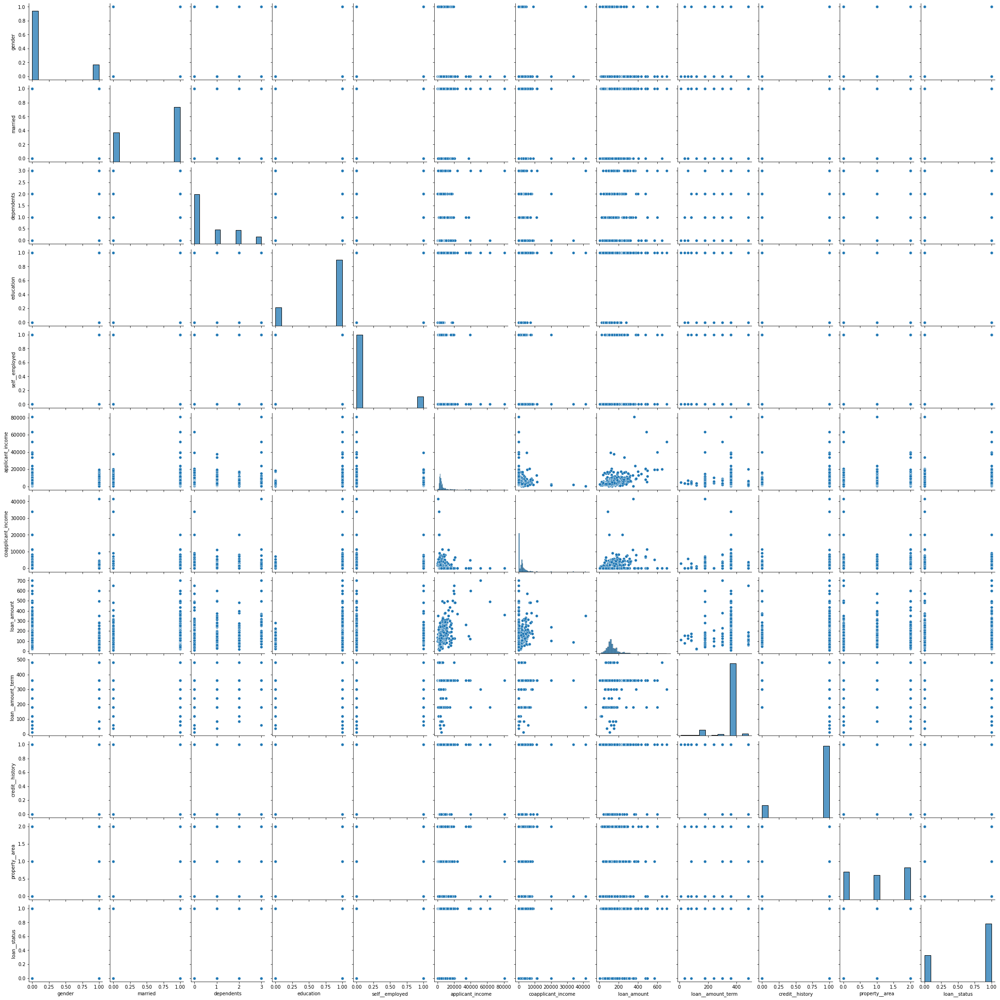

In [23]:

sns.pairplot(data);



##### Functions to create plots

In [24]:
def create_bar_dark(data_set,feature,ax= None):
    ''' Function to create a bar chart for the cateforical feature.
        data_set = DataFrame.
        feature = Categorical feature - string.
    '''
    # Set the background
    #plt.style.use()
    plt.style.use('default')
    # Create the title for the plot
    plot_title = ' '.join(feature.split("_")).title()
    # Define the plot size
    plt.figure(figsize=(12, 8))
    #Create the plot
    fig = sns.barplot(x=data_set[feature].value_counts(normalize=True).index,
                      y=data_set[feature].value_counts(normalize=True).round(4).values*100,
                      ax=ax)
    # Conditionaly place the data labels
    if data_set[feature].nunique() > 4:
        plt.xticks(rotation=90)
        fig.bar_label(fig.containers[0], label_type='edge', color='white')
    else:
        fig.bar_label(fig.containers[0], label_type='center', color='black')
    # Set the title of the plot
    fig.set_title(f'{plot_title} - Distribution in Percent',fontdict= { 'fontsize': 16},color = 'red',y=0.97)
    # Set the x-axis title
    fig.set_xlabel(plot_title)
    # Set the y-axis title
    fig.set_ylabel("Total Customers")
    # Turn the frame off
    fig.set_frame_on(False)
    # Turn the spines off
    sns.despine()


def create_numeric_plot(data_set, feature):
    ''' Function to create a box plot and histogram for the numerical feature.
        data_set = DataFrame.
        feature = Numerical feature - string.
    '''
    # Set subplots
    fig, axes = plt.subplots(1, 2)
    # Create the title for the plot
    plot_title = ' '.join(feature.split("_")).title()
    # Set the height of the plot
    fig.set_figheight(8)
    # Set the width of the plot
    fig.set_figwidth(10) #16
    # Create plots in each subplot with the title
    sns.boxplot(data=data_set, y=feature, ax=axes[0]).set_title('Box Plot')
    sns.histplot(data=data_set, x=feature,
                 ax=axes[1], binwidth=3, kde=True).set_title('Histogram') #binwidth was 6
    # Set the title of the plot
    fig.suptitle(plot_title, color='red', fontsize=24)
    # Turn the spines off
    sns.despine()



def bivariate_categorical(data_set, feature_1, feature_2,ax=None):
    ''' Function to create countplot for the categorical feature in relation to other categorical feature.
        data_set = DataFrame.
        feature_1 = Categorical feature - string - For which the countplot is to be created.
        feature_2 = Categorical feature - string - For which the relationship is to be checked.

    '''
    # Creare grids based on feature_2
    fig = sns.FacetGrid(data=data_set, col=feature_2, height=8, aspect=0.85)
    if data_set[feature_1].nunique() > 3:
        for axes in fig.axes.flat:
            axes.set_xticklabels(axes.get_xticklabels(), rotation=90)
    # Create the title for the plot
    plot_title = f"{' '.join(feature_1.split('_')).title()} and {' '.join(feature_2.split('_')).title()}"
    # Plot the countplot
    fig.map(sns.countplot,feature_1,ax=ax,order=data_set[feature_1].value_counts().index)
    # Turn the spines off
    fig.despine()
    # Set the title of the plot
    fig.figure.suptitle(plot_title, y=1.05, color='red', fontsize=24)
    

    

### 2.2.1 Data Exploration - Univariate
##### Categorical Features

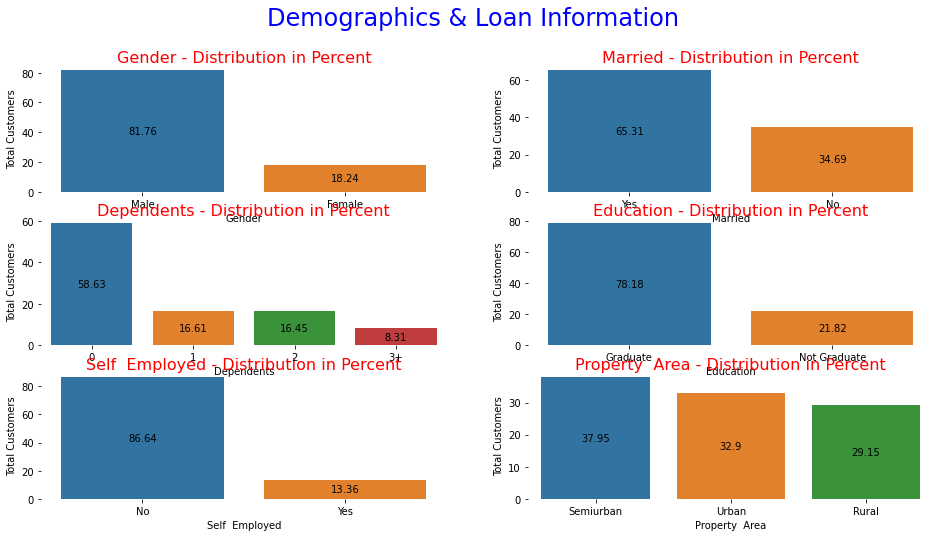

<Figure size 1200x800 with 0 Axes>

<Figure size 1200x800 with 0 Axes>

<Figure size 1200x800 with 0 Axes>

<Figure size 1200x800 with 0 Axes>

<Figure size 1200x800 with 0 Axes>

<Figure size 1200x800 with 0 Axes>

In [25]:
fig, axes = plt.subplots(3,2,figsize =(16,8))
create_bar_dark(df,'gender',ax=axes[0,0])
create_bar_dark(df,'married',ax=axes[0,1])
create_bar_dark(df, 'dependents',ax=axes[1,0])
create_bar_dark(df, 'education', ax=axes[1, 1])
create_bar_dark(df, 'self__employed', ax=axes[2, 0])
create_bar_dark(df, 'property__area', ax=axes[2, 1])
fig.suptitle("Demographics & Loan Information",color='blue',fontsize=24);

### 2.2.2 Data Exploration - Univariate

##### Numeric Features


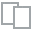
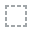
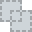
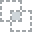
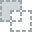
...
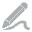
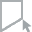
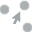
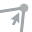
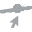

In [26]:
plot_correlation(df)

### histogram plot of all numeric features

In [27]:
#list of all the numeric columns
num = df.select_dtypes('number').columns.to_list()

#numeric df
df_num =  df[num]

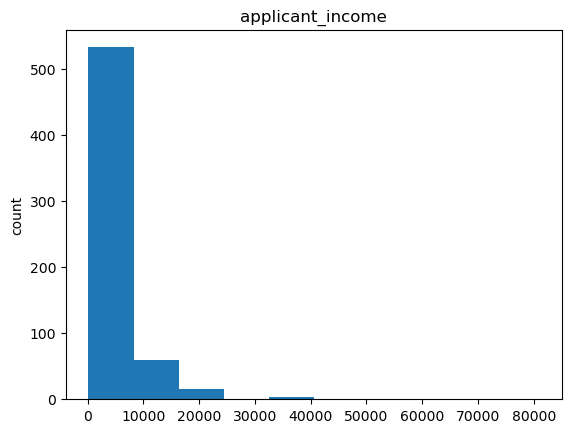

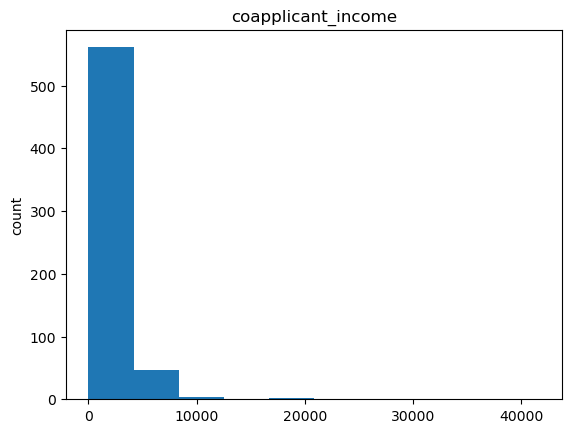

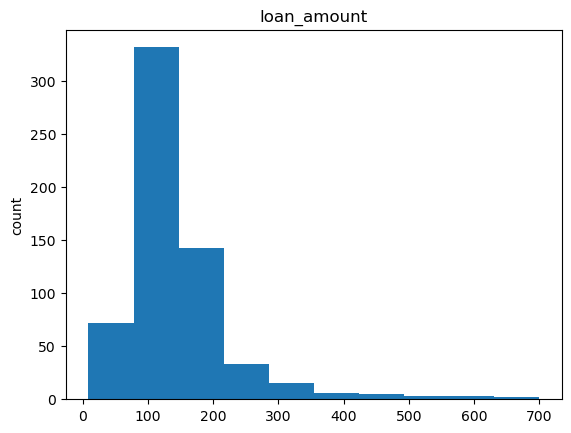

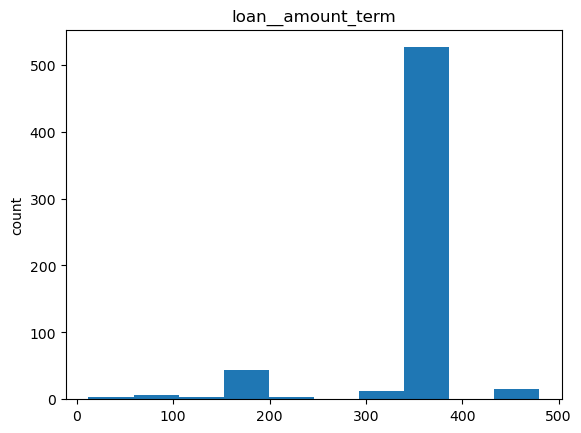

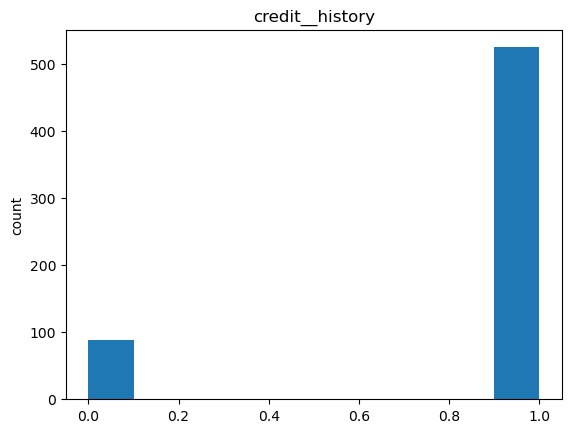

In [28]:
for i in df_num:
    plt.hist(df_num[i])
    plt.title(i)
    plt.ylabel('count')
    plt.show()

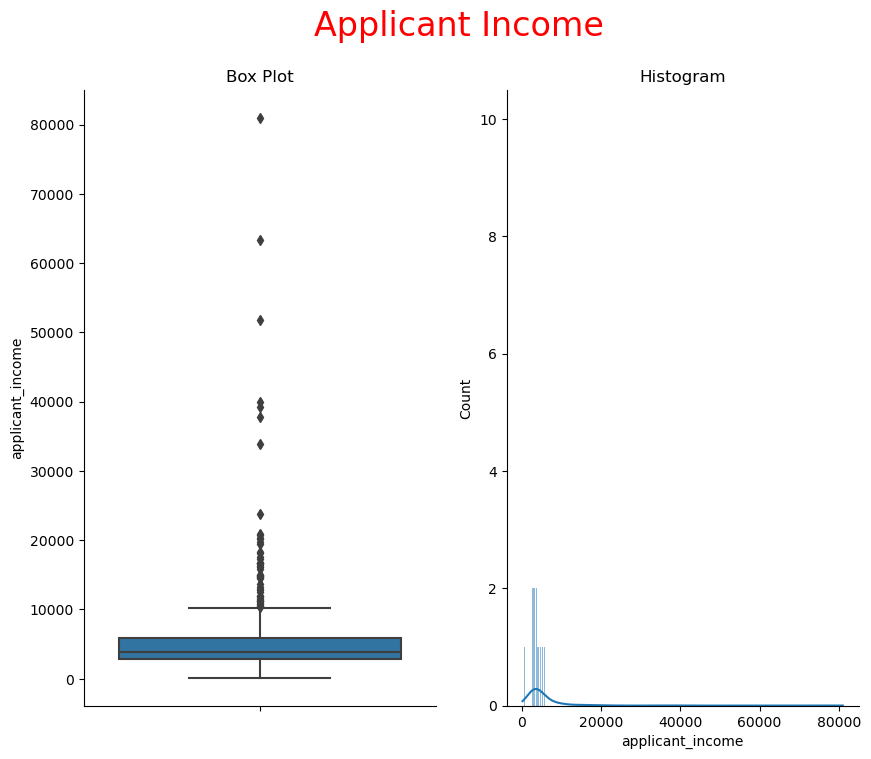

In [29]:
create_numeric_plot(df,'applicant_income')

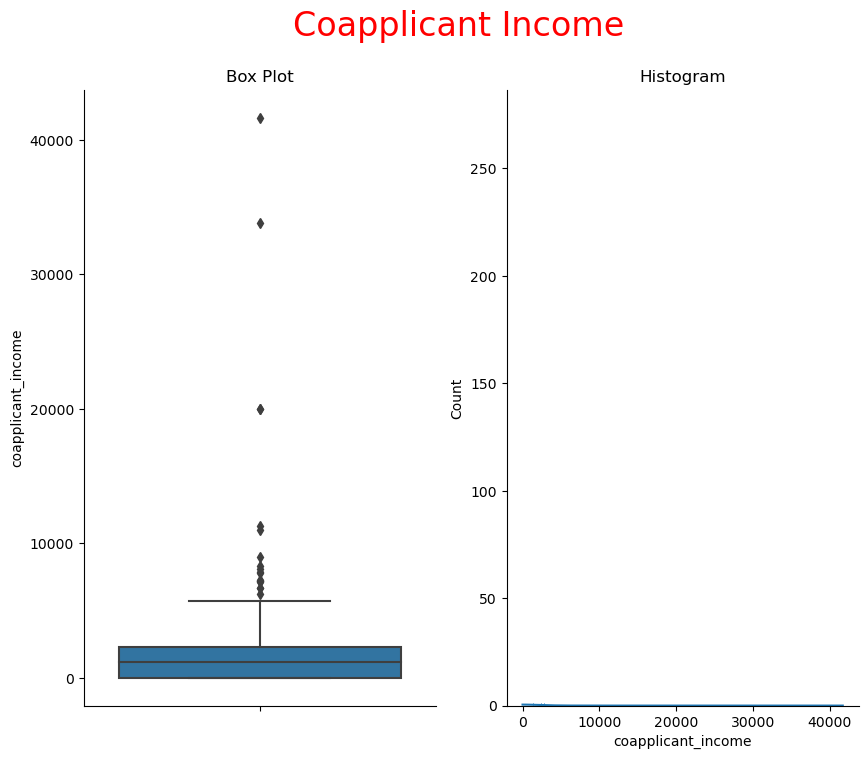

In [30]:
create_numeric_plot(df,'coapplicant_income')

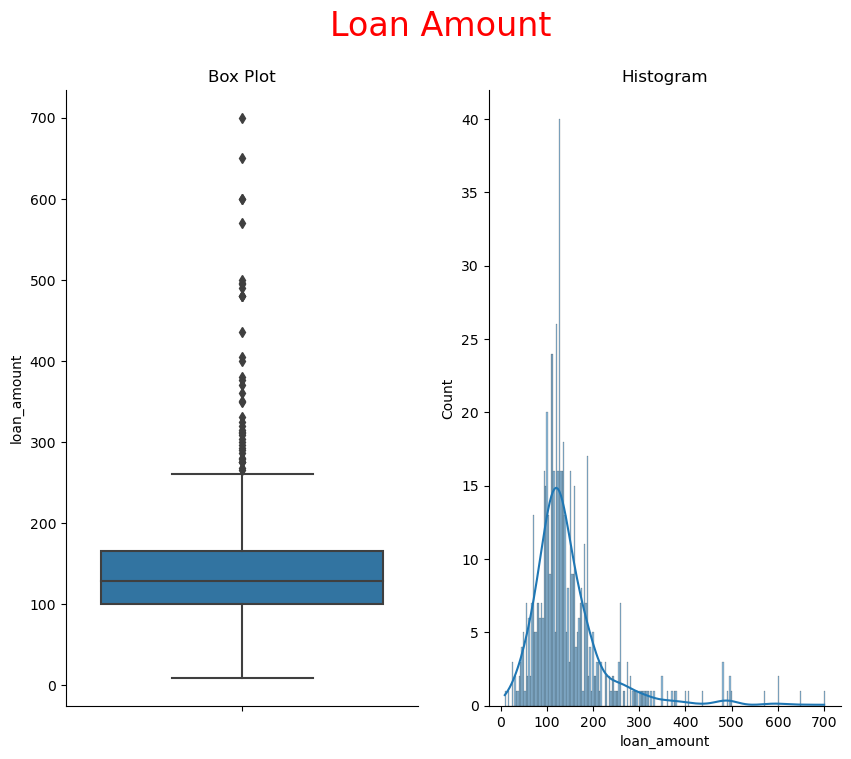

In [31]:
create_numeric_plot(df, 'loan_amount')

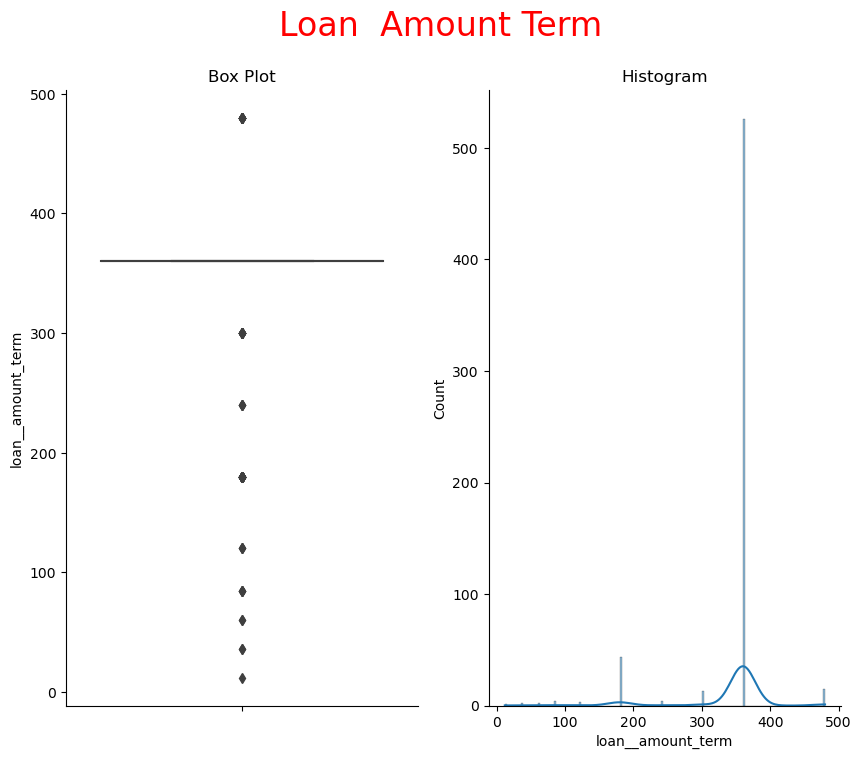

In [32]:
create_numeric_plot(df, 'loan__amount_term')

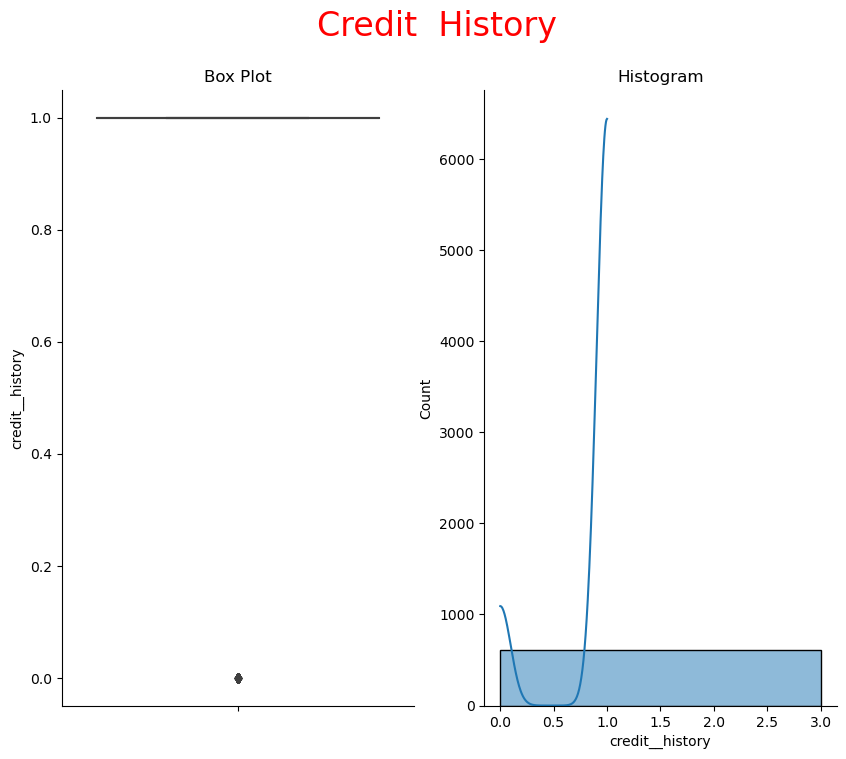

In [33]:
create_numeric_plot(df, 'credit__history')

### 2.3 Data Exploration - Bivariate
##### Catagorical Features

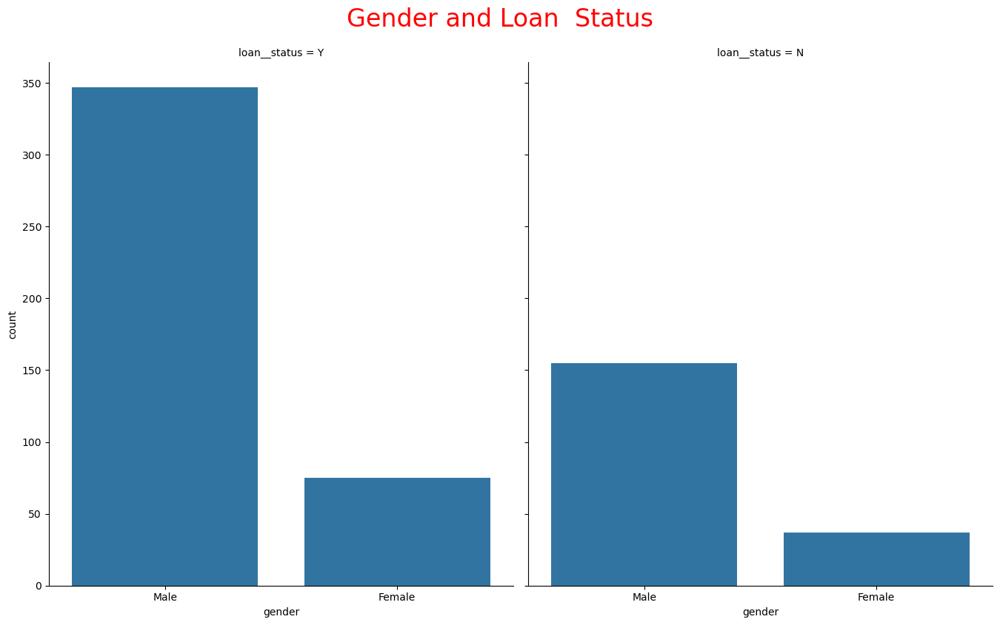

In [35]:
bivariate_categorical(df, 'gender','loan__status')


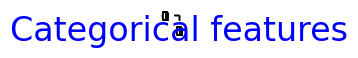

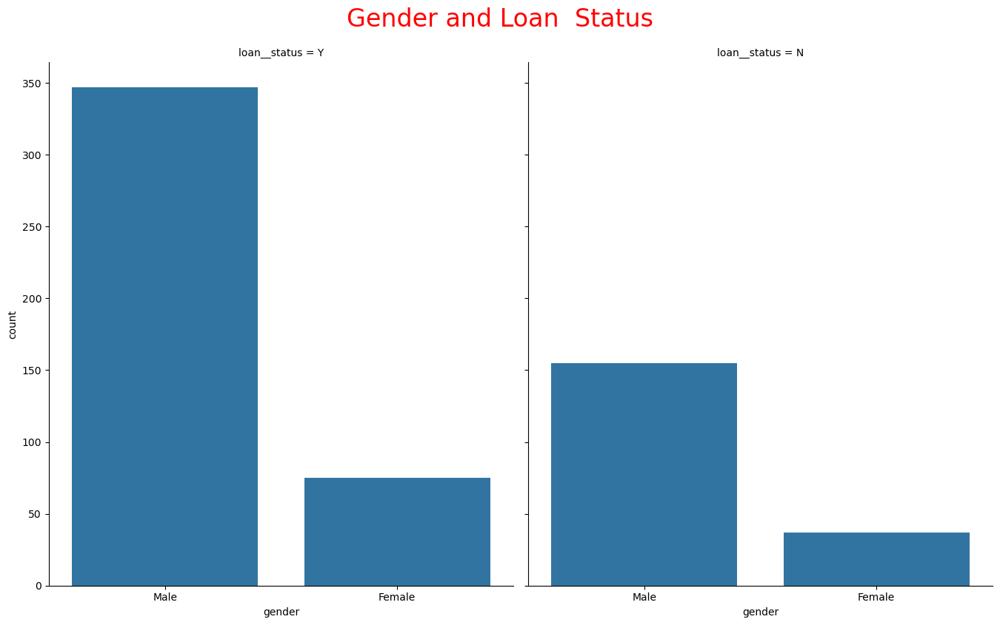

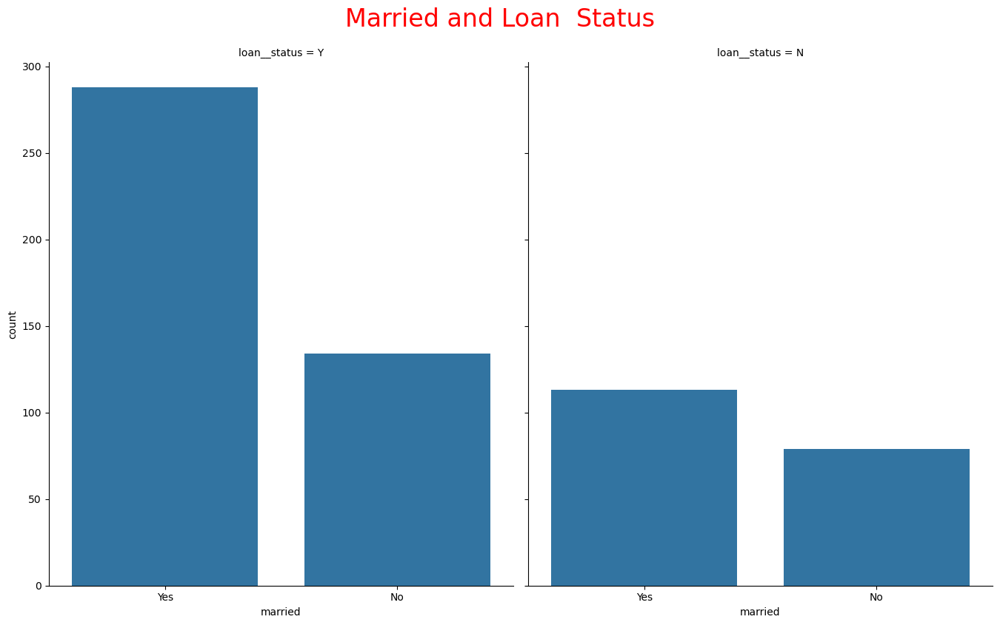

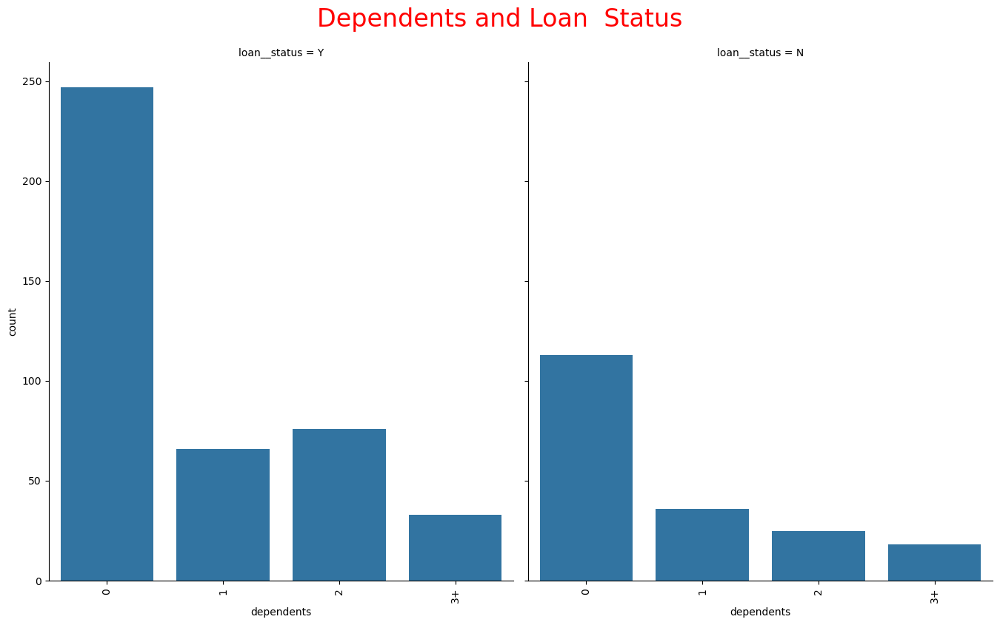

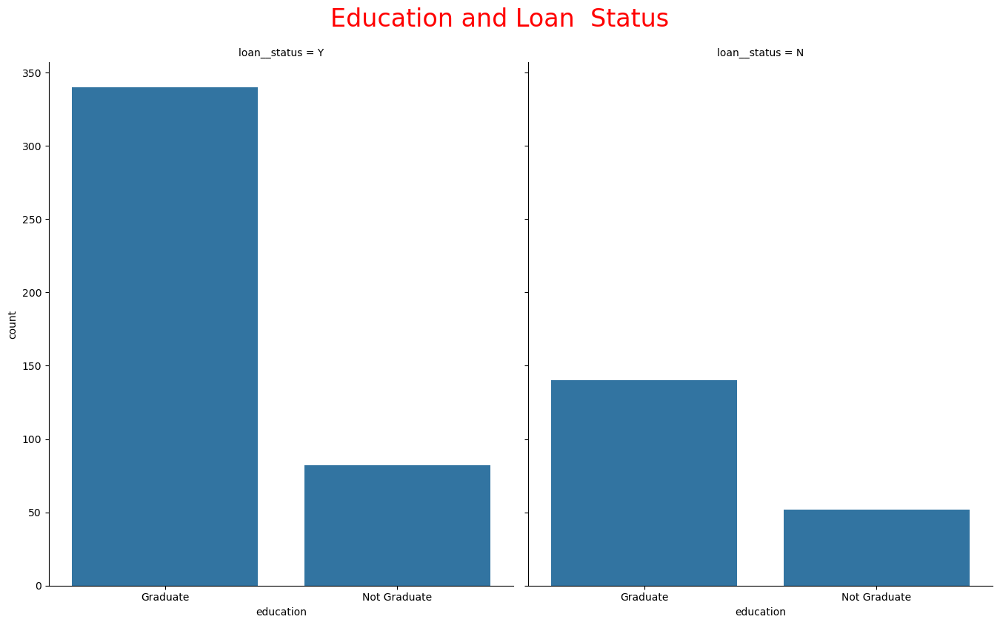

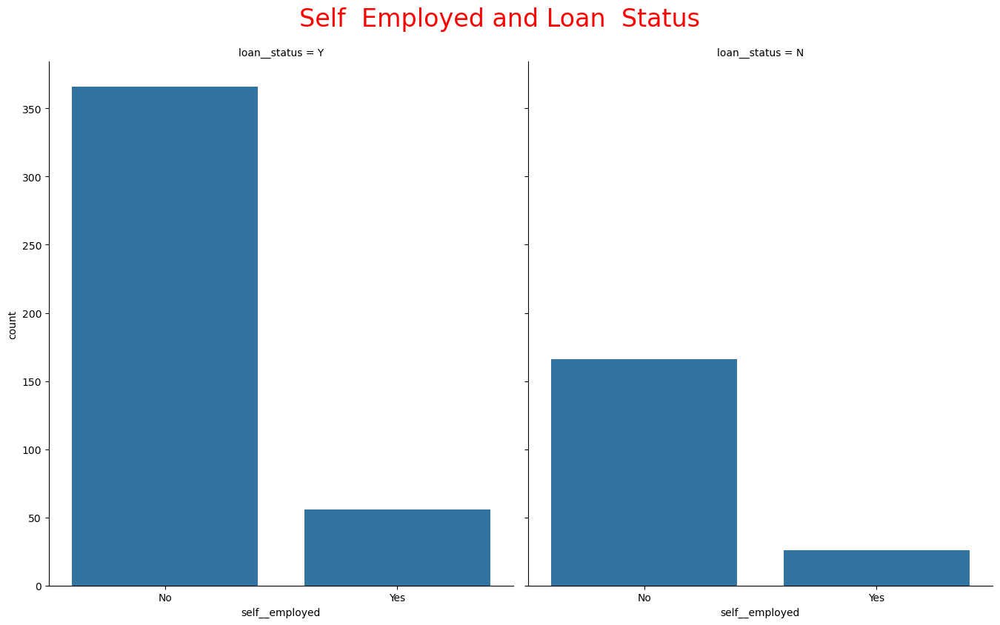

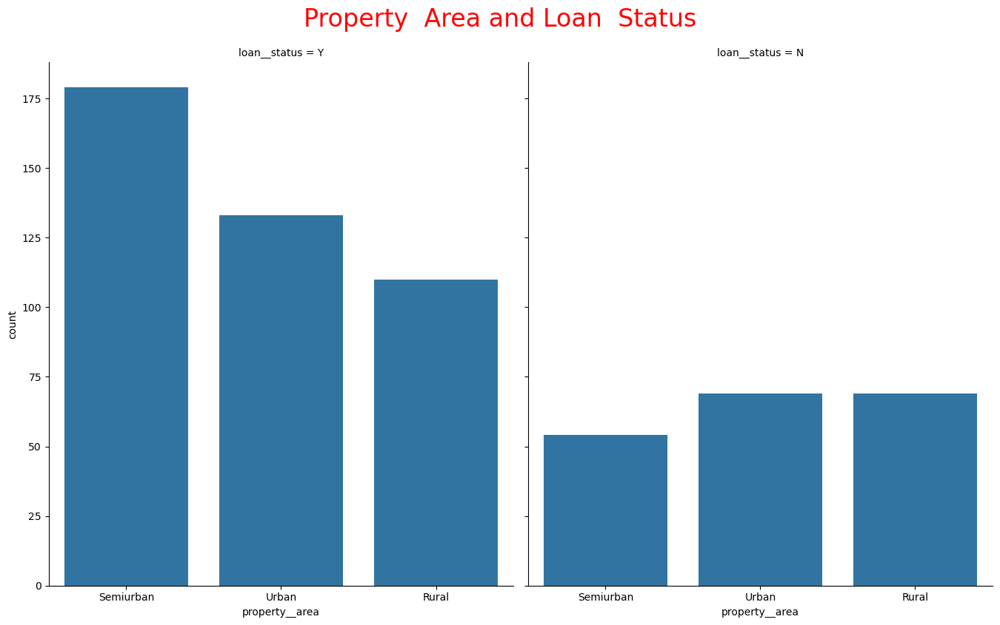

In [152]:
fig, axes = plt.subplots(3,2,figsize =(0,0))
bivariate_categorical(df, 'gender','loan__status',ax=axes[0,0])
bivariate_categorical(df,'married','loan__status',ax=axes[0,1])
bivariate_categorical(df, 'dependents','loan__status',ax=axes[1,0])
bivariate_categorical(df, 'education', 'loan__status',ax=axes[1,1])
bivariate_categorical(df, 'self__employed', 'loan__status',ax=axes[2,0])
bivariate_categorical(df, 'property__area', 'loan__status',ax=axes[2,1])
fig.suptitle("Categorical features",color='blue',fontsize=24);

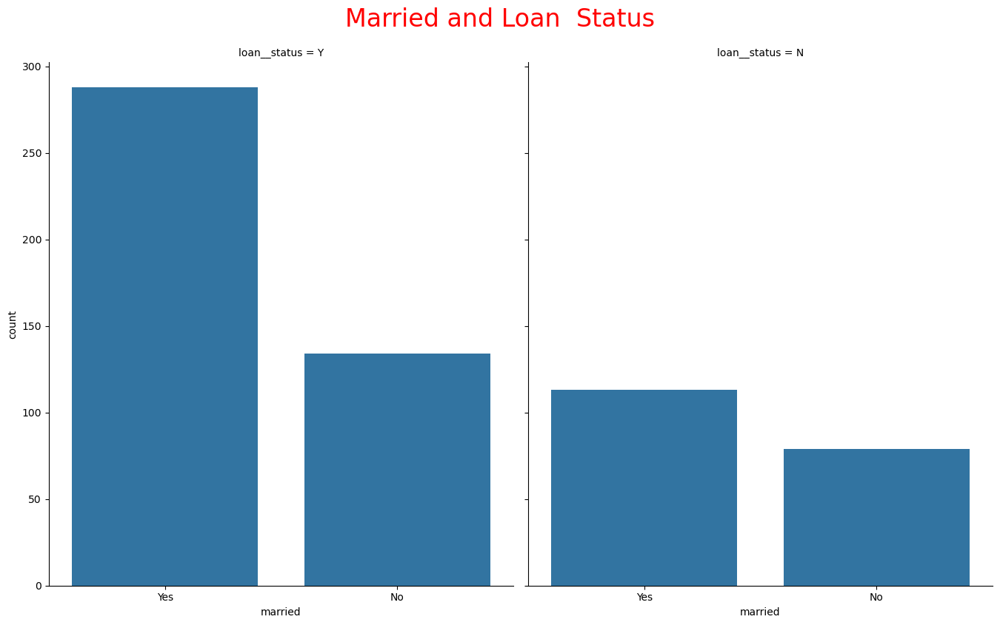

In [36]:
bivariate_categorical(df,'married','loan__status')

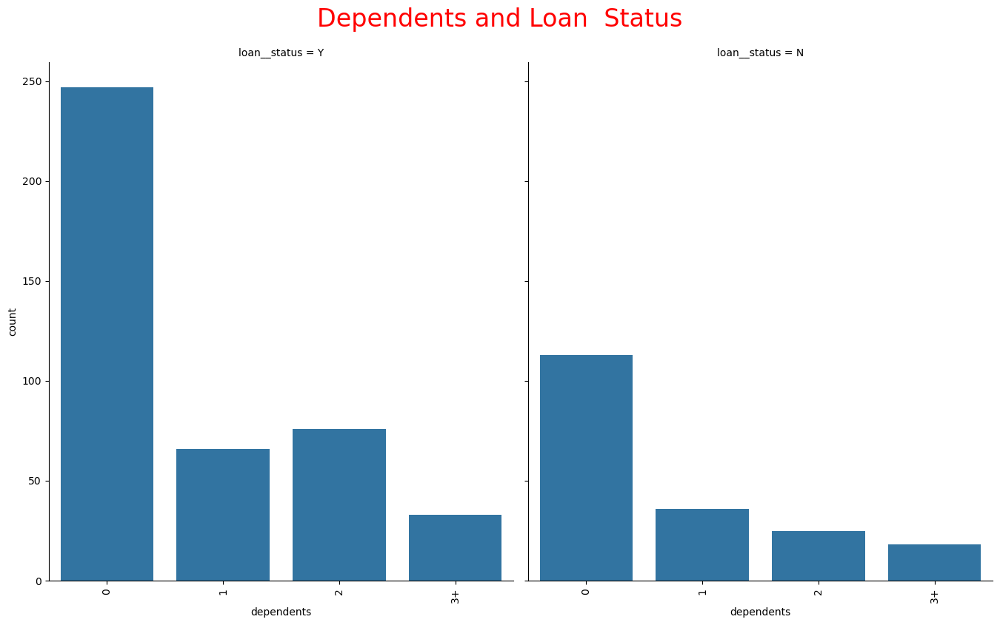

In [37]:
bivariate_categorical(df, 'dependents','loan__status')


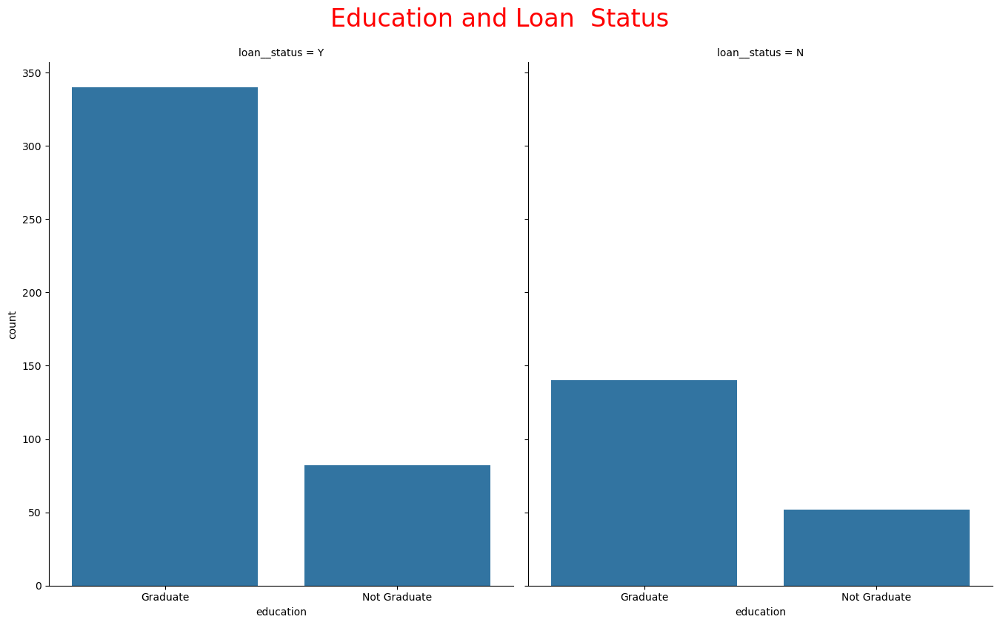

In [38]:
bivariate_categorical(df, 'education', 'loan__status')

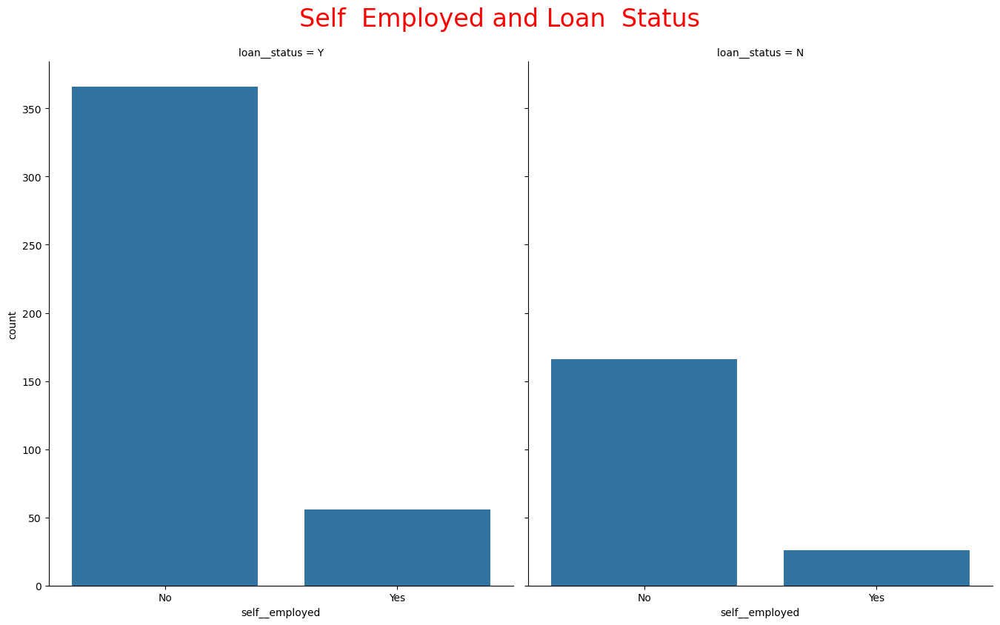

In [39]:
bivariate_categorical(df, 'self__employed', 'loan__status')

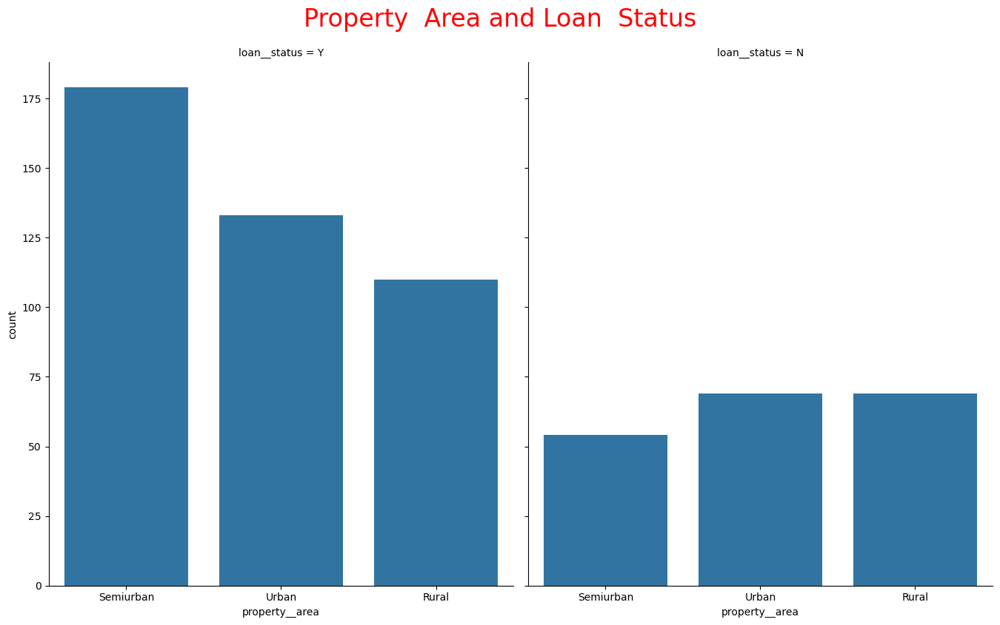

In [40]:
bivariate_categorical(df, 'property__area', 'loan__status')

### 2.4 Exploring the Target

#### It is important at this stage to explore and understand our target distribution. This helps us determine if we're facing a  highly imbalanced data problem. Some alogirthms require dealing with imbalanced data. 

In [41]:
df['loan__status'].value_counts(normalize=True)

Y    0.687296
N    0.312704
Name: loan__status, dtype: float64

In [153]:
target_instance = df['loan__status'].value_counts().to_frame()
target_instance = target_instance.reset_index()
target_instance = target_instance.rename(columns={'index': 'Category'})
fig = px.pie(target_instance, values='loan__status', names='Category', color_discrete_sequence=["blue", "white"],
             title='Pie chart Distribution of loan__status  {yes vs no }')
fig.show()

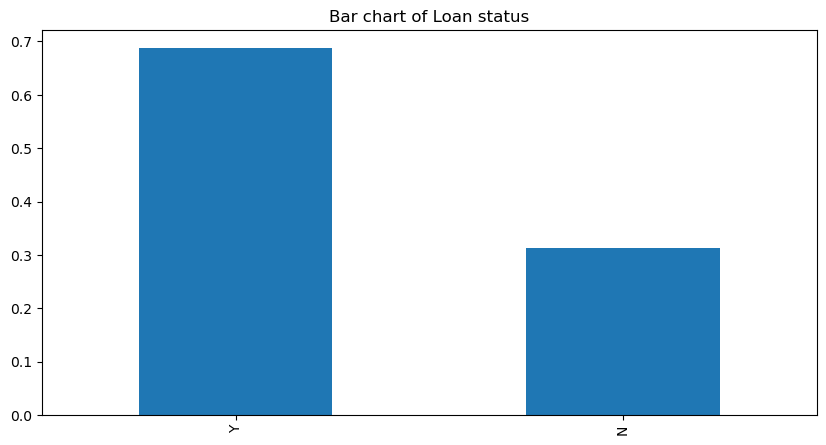

In [42]:
## defining target variable 
(df['loan__status'].value_counts()/df['loan__status'].size).plot(kind='bar', title='Bar chart of Loan status', figsize=(10,5));



#### The distribution of the target  shows that our data is imbalanced  so we applyy some oversampling techniques like SMOTE (Oversampling methods duplicate or create new synthetic examples in the minority class), we decided to make use of startified train-test splits since our dataset is relatively small to make sure each class of our target has equal representation in the train_test split. 

### 3. Model Building

In this section we will do the following:
1. Loan prediction.
    For this we will use the following features:
    - gender                 
    - married                        
    - dependents
    - education
    - self__employed  
    - property__area
    - applicant_income   
    - coapplicant_income 
    - loan_amount  
    - loan__amount_term    
    - credit__history

We will use the following algorithms:
1. Logistic Regression
2. KNN Classifier
3. Decision Tree
4. Random Forest
5. MLPClassifier - Neural netwok

    

In [43]:
df['loan__status']

0      Y
1      N
2      Y
3      Y
4      Y
      ..
609    Y
610    Y
611    Y
612    Y
613    N
Name: loan__status, Length: 614, dtype: object

In [44]:
def mapping_target(data_set,target):
    '''Function to map the loan__status column to calculate total number of y & n
       data_set = DataFrame
       feature = Categorical target - string'''
    # Intantiate an empty dictionary
    map_dict = dict()
    # Loop through the unique values in the target and update the dictionary
    for _ in data_set[target].unique():
        if _ == 'Y' :
            map_dict[_] = 1
        else:
            map_dict[_] = 0
        
    return data_set[target].map(map_dict)

#### Stratified Train-Test Splits

We are dealing with a classification problem. Our  classification problem does not have a balanced number of samples for each class label. As such, it is desirable to split the dataset into train and test sets in a way that preserves the same proportions of samples in each class.

Thus, we make use of  stratified train-test split.

We can achieve this by setting the “stratify” argument to the y component of the original dataset. This will be used by the train_test_split() function. 

In [96]:
# Define X and y
X = df.drop(columns=['loan__status'])
y = mapping_target(df,'loan__status')
# Define categorical features and numerical features
cat_cols = ['gender', 'married', 'dependents', 'education', 'self__employed', 'property__area' ]
num_cols = ['applicant_income', 'coapplicant_income',  'loan_amount',  'loan__amount_term',  'credit__history']
# Split the data in train and test
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=0,stratify=y)



#### Feature Scaling:
Normalization- To standardize the input X train to zero mean and unit variance before fitting the estimator, we can try the StandardScaler()
- z = (x - mean(x)) / std
- mean = 0
- STD = 1

#### Feature Encoding- We want to handle our categorical variables. 
There are many ways of handling categorical variables but the method we'll go through today is called One-Hot Encoding (OHE) using sklearn.


#### SMOTE Technique (Over-Sampling) 
Synthetic Minority Oversampling Technique (SMOTE) synthesizes new examples from the minority class to make the dataset balanced.
smote gives you more synthetic dataset which is not exactly the same as the original dataset which helps the model to perform better and improve the accuracy unlike random oversampling which just creates new samples of the minority class

In [46]:
# Instantiate Onehotencoder
ohe = OneHotEncoder(drop = 'first')
# Instantiate scaler
scaler = StandardScaler()
# Instantiate transformer
transformer = ColumnTransformer([('cat_cols', ohe, cat_cols), ('num_cols', scaler, num_cols)])

In [104]:
from imblearn.pipeline import Pipeline 

In [125]:

# Intentiate LogisticRegression 
lr = LogisticRegression(random_state=13,max_iter=100)
# Instantiate DecisionTreeClassifier
dt = DecisionTreeClassifier(random_state=13)
# Intstantiate RandomForestClassifier
rf = RandomForestClassifier(random_state=13)
# Instantiate KNNClassifier
knn = KNeighborsClassifier()
# Instantiate MLPClassifier
mlp = MLPClassifier(random_state=13)

# Make a list of all the models
models = [lr,dt,rf,knn,mlp]
# Store the resuts
accuracy = []
recall = []
f_1 = []
roc_auc = []
ind  =[]
precison = []
#sm = SMOTE(random_state=13)

# Make a pipe line and run it and store results
for model in models:
    pipe = Pipeline([('preprocessing', transformer), ('oversample', SMOTE(sampling_strategy='minority', random_state=13)), ('classification', model)])
    pipe.fit(X_train, y_train)
    y_pred = pipe.predict(X_test)

    accuracy.append(accuracy_score(y_test, y_pred))
    recall.append(recall_score(y_test, y_pred))
    f_1.append(f1_score(y_test, y_pred))
    roc_auc.append(roc_auc_score(y_test, y_pred))
    ind.append(f'{model}'.split()[0].split('(')[0])
    precison.append(precision_score(y_test,y_pred))

In [126]:
# Function to plot results
def plot_resutls(list_1,list_2,title,ax=None):
    fig = sns.barplot(x=list_1,y=list_2,ax=ax)
    fig.set_title(title.upper(),
              fontdict={'fontsize': 16}, color='red', y=1)
    fig.bar_label(fig.containers[0], label_type='center', color='black')


### 3.1 Model Evaluation

###  Classification Evaluation Metrics

- The following classification evaluation metrics will be employed:
`
**metrics.accuracy_score**                  Accuracy classification score. 
**metrics.recall_score**                    Compute the recall  
**metrics.f1_score**                        Compute the F1 score, also known as balanced F-score or F-measu
**metrics.roc_auc_score**                   Compute (ROC AUC) from prediction scores.  
**metrics.precision_score**                 Compute the precision  
**metrics.roc_curve**                       Compute Receiver operating characteristic (ROC) 
**metrics.confusion_matrix**                Compute confusion matrix to evaluate the accuracy of a classification 
`


**Accuracy**

Accuracy is not a good metric for imbalanced datasets. Say we have an imbalanced dataset and a badly performing model which always predicts for the majority class. This model would receive a very good accuracy score as it predicted correctly for the majority of observations, but this hides the true performance of the model which is objectively not good as it only predicts for one class. We have dealt with our imbalanced data so now accuracy can be used as a good classification evaluation metrics




**Precision**
> - The precision is the ratio ``tp / (tp + fp)`` where ``tp`` is the number of true positives and ``fp`` the number of false positives. The precision is intuitively the ability of the classifier not to label as positive a sample that is negative.
> - The best value is 1 and the worst value is 0.

**Recall**
> - The recall is the ratio ``tp / (tp + fn)`` where ``tp`` is the number of true positives and ``fn`` the number of false negatives. The recall is intuitively the ability of the classifier to find all the positive samples.
> - The best value is 1 and the worst value is 0.

**f1_score**

> The F1 score can be interpreted as a weighted average of the precision and recall, where an F1 score reaches its best value at 1 and worst score at 0.

> The relative contribution of precision and recall to the F1 score are equal.




**Precision = TP/(TP+FP)**

**Recall = TP/(TP+FN)**

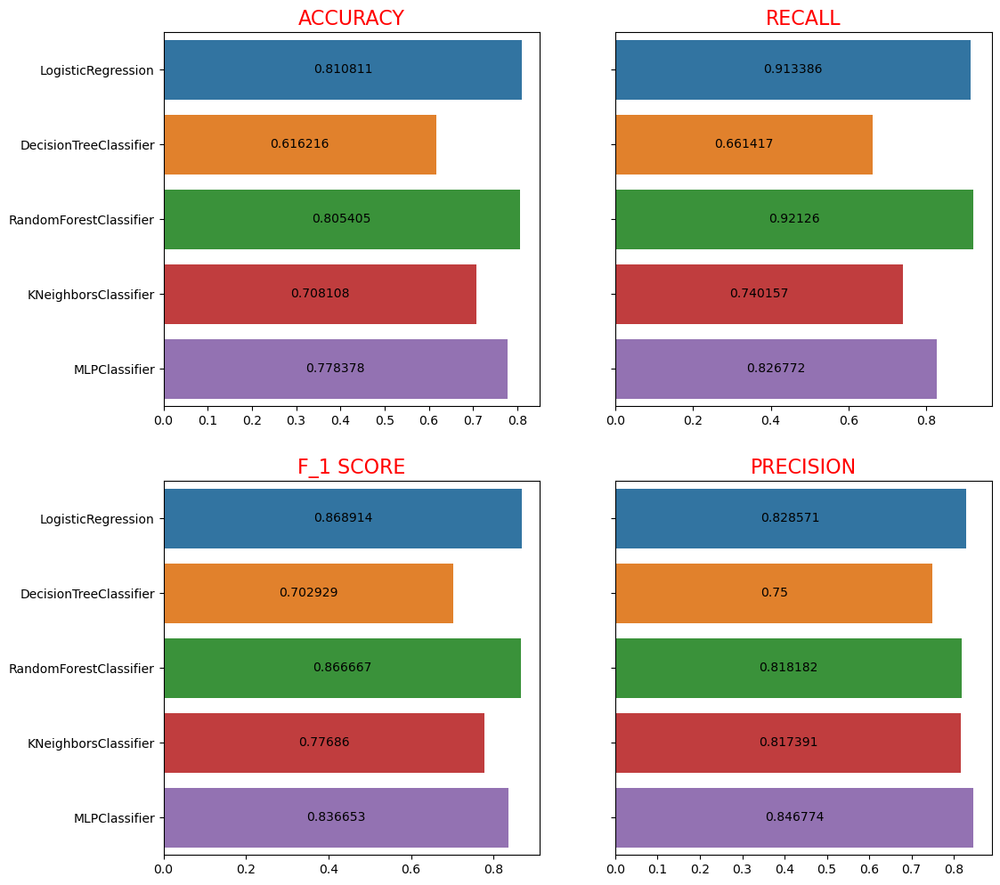

In [127]:
fig, axes = plt.subplots(2,2,figsize=(12,12),sharey=True)
plot_resutls(accuracy,ind,'Accuracy',ax=axes[0,0])
plot_resutls(recall, ind, 'recall', ax=axes[0, 1])
plot_resutls(f_1, ind, 'f_1 score', ax=axes[1, 0])
plot_resutls(precison, ind, 'precision', ax=axes[1, 1])

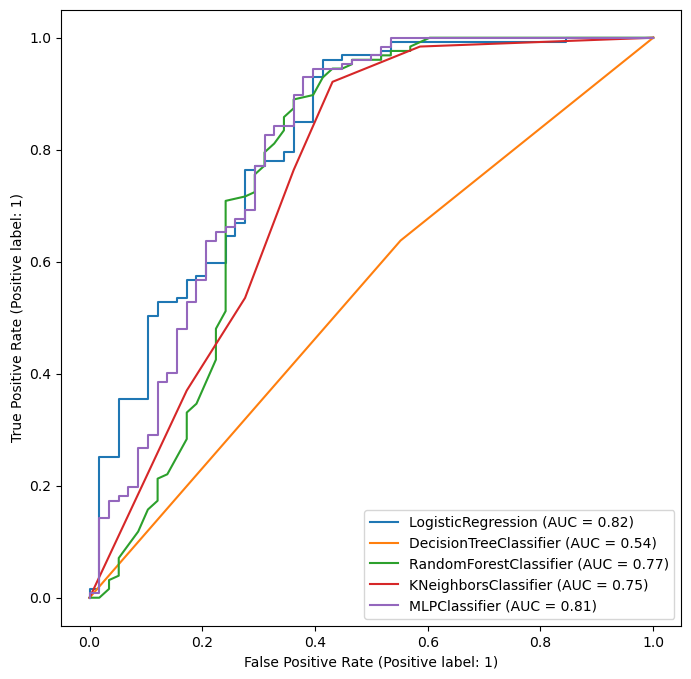

In [128]:
ax=plt.gca()
ax.figure.set_figheight(8)
ax.figure.set_figwidth(8)
plot_roc_curve(lr,transformer.fit_transform(X_test),y_test,ax=ax)
plot_roc_curve(dt, transformer.fit_transform(X_test), y_test, ax=ax)
plot_roc_curve(rf, transformer.fit_transform(X_test), y_test, ax=ax)
plot_roc_curve(knn, transformer.fit_transform(X_test), y_test, ax=ax)
plot_roc_curve(mlp, transformer.fit_transform(X_test), y_test, ax=ax)


# plot_precision_recall_curve (lr, transformer.fit_transform(X_test), y_test,ax=ax)




The ROC curve of a good classifier is closer to the top left of the graph.  Because in a good classifier, we can achieve high TPR at low FPR (at optimal threshold. 

ROC curve helps us visualize how well our machine learning classifier is performing. Although it works for only binary classification problems

<center><h2>Confusion Matrix

<img src='https://i1.wp.com/dataaspirant.com/wp-content/uploads/2020/08/3_confusion_matrix.png?ssl=1' width = 400><img >

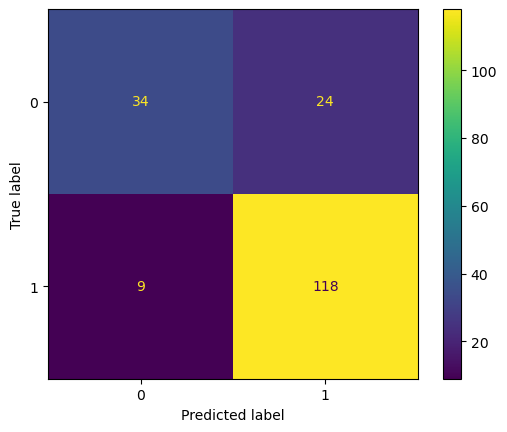

In [120]:
plot_confusion_matrix(lr,transformer.fit_transform(X_test),y_test)

#### Insights from  Data Exploration 

-- Gender Distribution: Males in the dataset are way more than females in the dataset i.e 81.76% to 18.24%. We have more male applicants 

-- Married: Only around 34.69% customers are not married. Majority of the loan applicants are married.

-- Dependents: Only 41.37% customers have dependents. Majority of the loan applicants do not have dependents.

-- Education:  more than 78% customers are educated. Majority of the loan applicants are educated.

-- Self Employed: Only about 13.36% customers are self employed. Majority of the loan applicants are not self employed

-- Property Area:  Majority (37.95%) of the customers have property in the Semi-Urban Areas followed by Urban areas(32.9%) with the remianing being in the rural areas.
 
--  Gender - Males have more loans approved than the females and they also have more loans rejected than the females. This makes sense because we have way more males in the dataset than females.

-- Married- Married people have way more loans approved than people not married.

--  Dependents- Loan Applicants with no dependents have more loans approved than loan applicants with dependents

--  Education- Loan applicants who are graduates have their loans approved way more than applicants who are not graduates

--  Self Employed- Loan applicants who are not self employed have their loans approved way more than applicants who are self employed.

-- Even after the EDA, I would say  there is still no unique factor/metrics to determine loan status.
    





#### For our  Loan Status approval prediction project, fp in our business case here is like loaning to a wrong applicant i.e The applicant should have been rejected maybe due to bad credit score or other factors( i.e increased risk), the loan might not be repaid or might become bad debt which affects the bank.  fn in our business case here like rejecting the loan of a right applicant so you are missing out on potential benefit or losing potential clients or source of income. We want to stay on the side of caution hence FP is more costly  than FN hence the classifier that can generate higher precision is the best.









From the Exploratory Data Analysis, we could generate insight from the data. How each of the features relates to the target. Also, it can be seen from the evaluation of five models that Logistic Regression performed the best based on the classification metrics like precision, roc curve, accuracy, f1 score.


### Recommendation to improve the model in the future

-- Better feature engineering (preprocessing/scaling)

-- Feature selection

-- Collection of better/more data

-- Trying more Algorithms i.e more complex algorithms like xgboost, ensemble techniques like bagging, bootstrap

-- Hyperparamter tuning like gridsearch to identify best paramters for each algorithm 

-- GridSearchCV is used to determine the paremeters that gives the best predictive score for the classifiers

-- Performing model validation 

REFERENCES

-- https://www.kaggle.com/datasets/altruistdelhite04/loan-prediction-problem-dataset?select=train_u6lujuX_CVtuZ9i.csv

-- https://github.com/omotuno/wecloud-project/blob/main/telecom_churn%20.ipynb

-- https://www.kaggle.com/code/yonatanrabinovich/loan-prediction-dataset-ml-project
    
-- Loan Approval Prediction Machine Learning by Vedansh Shrivastava, published on feb 4, 2022. https://www.analyticsvidhya.com/blog/2022/02/loan-approval-prediction-machine-learning/

-- https://www.projectpro.io/article/loan-prediction-using-machine-learning-project-source-code/632#mcetoc_1gbmktaons

-- https://medium.com/@pinnzonandres/loan-prediction-with-python-d32cf65b5443
    
-- Ernest Owojori Loan prediction using selected machine learning, Nov 30, 2019. https://medium.com/devcareers/loan-prediction-using-selected-machine-learning-algorithms-1bdc00717631
    
-- https://www.geeksforgeeks.org/loan-approval-prediction-using-machine-learning/
    
-- https://www.kaggle.com/code/yaheaal/loan-status-with-different-models
    
-- https://medium.com/@shetty.deeksha100/explore-your-dataset-within-seconds-thanks-to-a-few-magical-codes-6fe178e029e0

-- https://www.analyticsvidhya.com/blog/2020/06/auc-roc-curve-machine-learning/